# EDA - Primary OHLC Daily

In [ ]:
# import libraries
import algoseek_connector
import pandas as pd


Primary OHLC Daily Datafield:

| Field                   | Type (Format)     | Description                  |
|-------------------------|-------------------|------------------------------|
| SecId                   | integer           | algoseek unique security id  |
| TradeDate               | string (YYYYMMDD) | Trading date in YYYYMMDD format |
| Ticker                  | string            | Symbol name |
| Name                    | string            | Name of Equity Security |
| PrimaryExchange         | string            | Primary listing exchange on this trade date |
| ISIN                    | string            | ISIN as of this trade date |
| OpenPrice               | decimal           | Primary exchange opening trade (see section “Opening Trade Identification”) |
| OpenSize                | integer           |  Primary exchange open trade size |
| OpenTime                | time | Time of the primary exchange opening trade |
| HighPrice               | decimal | Highest trade price from any exchange or Trade Reporting Facility (TRF) |
| HighTime                | time | Time of the highest trade |
| LowPrice                | decimal | Lowest trade price from any exchange or Trade Reporting Facility (TRF) |
| LowTime                 | time | Time of the lowest trade |
| ClosePrice              | decimal | Primary exchange closing trade (see section “Closing Trade Identification”) |
| CloseSize               | integer | Primary exchange close trade size |
| CloseTime               | time | Time of the primary exchange closing trade |
| ListedMarketHoursVolume | integer | Public Listed exchanges trading volume during regular market hours only |
| ListedMarketHoursTrades | integer | Number of trades during regular market hours in public listed exchanges |
| ListedTotalVolume       | integer | Public Listed exchanges trading volume for the whole day (includes pre, regular, and post-market) |
| ListedTotalTrades       | integer | Public Total number of trades for the trade date (includes pre-, regular, and post-market) in listed exchanges |
| FinraMarketHoursVolume  | integer | FINRA/TRF trading volume during regular market hours only (normal trade day is 09:30:00 to 16:00:00 EST). FINRA/TRP represents off-exchange trading. |
| FinraMarketHoursTrades  | integer | The number of FINRA/TRF trades during regular market hours. FINRA/TRF represents off-exchange trading. |
| FinraTotalVolume        | integer | FINRA/TRF trading volume for the whole day (includes pre-, regular, and post-market) |
| FinraTotalTrades        | integer | Total number of FINRA/TRF trades for the trade date (includes pre, regular, and post-market). FINRA/TRF represents off-exchange trading. |
| MarketVWAP | decimal | Volume weighted average price during regular market hours, normally between 09:30:00 and 16:00:00 EST plus the Opening and Closing Cross (which may be after 16:00:00 EST) |
| DailyVWAP | decimal | Volume weighted average price for the whole day including pre, regular, and post-market trades |



In [1]:
import algoseek_connector
import algoseek_connector.functions as fn
import pandas as pd
import os
from dotenv import load_dotenv
import pandas_ta as ta
import seaborn as sns
import plotly.graph_objects as go
import plotly
from plotly.subplots import make_subplots
import pandas_ta as ta
import matplotlib.pyplot as plt
import plotly.express as px

os.chdir('ml4t')

pd.set_option('display.max_columns',150)
pd.set_option('display.max_rows', 100)

load_dotenv()

jhost = os.getenv('host_julian')
juser = os.getenv('user_julian')
jpass = os.getenv('password_julian')

session = algoseek_connector.Session(
    jhost, juser,jpass
)
session.ping() # Verify that the session was instantiated corrected
resource = algoseek_connector.DataResource(session)
look = pd.read_parquet('data/us_equity/ref/lookup.parquet')
tickers = look['Ticker'].unique()

deque([('54.209.205.114', 9000)])

In [8]:
primary_adj = resource.datagroups.USEquityMarketData.datasets.PrimaryAdjustedOHLCDaily
primary_adj.meta

In [ ]:
sec = resource.datagroups.USEquityReferenceData.datasets.SecMasterBase.

In [4]:
files = os.listdir('data/us_equity/primary_daily/')

In [5]:
files

['COMG.parquet',
 'SFTW.U.parquet',
 'EPU.parquet',
 'MMLP.parquet',
 'PVBC.parquet',
 'CUBIpE.parquet',
 'GLUr.parquet',
 'TZPS.parquet',
 'ANDW.parquet',
 'ETACU.parquet',
 'STXN.parquet',
 'CCOI.parquet',
 'GBLIL.parquet',
 'INFU.parquet',
 'SEPZ.parquet',
 'KCLI.parquet',
 'DSCM.parquet',
 'EYESW.parquet',
 'ISVL.parquet',
 'ACTCU.parquet',
 'ACPr.parquet',
 'EFUT.parquet',
 'ECGI.parquet',
 'DGF.parquet',
 'IDG.parquet',
 'TRBC.parquet',
 'KYN.parquet',
 'PLL.parquet',
 'VSH.parquet',
 'GRU.parquet',
 'GOM.parquet',
 'COV.parquet',
 'ALPpP.parquet',
 'NAHC.parquet',
 'LCNB.parquet',
 'VCVCU.parquet',
 'PEBpB.CL.parquet',
 'JNP.parquet',
 'ZGN.parquet',
 'BFIIW.parquet',
 'OMFL.parquet',
 'RENEW.parquet',
 'EUM.parquet',
 'PIJ.CL.parquet',
 'CWEN.parquet',
 'XSD.parquet',
 'IOO.parquet',
 'MLNM.parquet',
 'ERIC.parquet',
 'TRBN.parquet',
 'PSApY.CL.parquet',
 'ERO.parquet',
 'DKA.parquet',
 'GAINM.parquet',
 'VITL.parquet',
 'SCSC.parquet',
 'VEDU.parquet',
 'AGCO.parquet',
 'INUV.

In [ ]:
from tqdm import tqdm
all = []
for file in tqdm(files):
    tic = pd.read_parquet('data/us_equity/primary_daily/'+file)
    all.append(tic)

all = pd.concat(all)

100%|████████████████████████████████████████████████████████| 24745/24745 [03:15<00:00, 126.56it/s]


In [ ]:
primary_ohlc_daily = resource.datagroups.USEquityMarketData.datasets.PrimaryOHLCDaily

aapl = primary_ohlc_daily.select(
       primary_ohlc_daily.TradeDate,
       primary_ohlc_daily.SecId,
       primary_ohlc_daily.Ticker,
       primary_ohlc_daily.Name,
       primary_ohlc_daily.PrimaryExchange,
       primary_ohlc_daily.ISIN,
       primary_ohlc_daily.OpenTime,
       primary_ohlc_daily.OpenPrice,
       primary_ohlc_daily.OpenSize,
       primary_ohlc_daily.HighTime,
       primary_ohlc_daily.HighPrice,
       primary_ohlc_daily.LowTime,
       primary_ohlc_daily.LowPrice,
       primary_ohlc_daily.CloseTime,
       primary_ohlc_daily.ClosePrice,
       primary_ohlc_daily.CloseSize,
       primary_ohlc_daily.ListedMarketHoursVolume,
       primary_ohlc_daily.ListedMarketHoursTrades,
       primary_ohlc_daily.ListedTotalVolume,
       primary_ohlc_daily.ListedTotalTrades,
       primary_ohlc_daily.FinraMarketHoursVolume,
       primary_ohlc_daily.FinraMarketHoursTrades,
       primary_ohlc_daily.FinraTotalVolume,
       primary_ohlc_daily.FinraTotalTrades,
       primary_ohlc_daily.MarketVWAP,
       primary_ohlc_daily.DailyVWAP
).filter(
    (primary_ohlc_daily.Ticker=='AAPL')
).fetch()

In [6]:
aapl = pd.read_parquet('data/us_equity/primary_daily/AAPL.parquet')

In [7]:
aapl

,TradeDate,SecId,Ticker,Name,PrimaryExchange,ISIN,OpenTime,OpenPrice,OpenSize,HighTime,HighPrice,LowTime,LowPrice,CloseTime,ClosePrice,CloseSize,ListedMarketHoursVolume,ListedMarketHoursTrades,ListedTotalVolume,ListedTotalTrades,FinraMarketHoursVolume,FinraMarketHoursTrades,FinraTotalVolume,FinraTotalTrades,MarketVWAP,DailyVWAP
0,2007-01-03,33449,AAPL,Apple Computer Inc.,NASDAQ,US0378331005,2007-01-03 09:30:00.314000-05:00,86.28,352307,2007-01-03 09:34:21.257000-05:00,86.58,2007-01-03 14:57:49.166000-05:00,81.90,2007-01-03 15:59:57.935000-05:00,83.76,238041,32736079,161182,33565579,163074,10696551,24849,11540291,26700,84.85,84.85
1,2007-01-04,33449,AAPL,Apple Computer Inc.,NASDAQ,US0378331005,2007-01-04 09:30:00.994000-05:00,84.17,154030,2007-01-04 15:39:45.135000-05:00,85.95,2007-01-04 09:36:25.673000-05:00,83.82,2007-01-04 16:00:02.831000-05:00,85.66,166897,22008327,116232,22611158,117623,7804137,17970,8317690,18734,85.12,85.13
2,2007-01-05,33449,AAPL,Apple Computer Inc.,NASDAQ,US0378331005,2007-01-05 09:30:00.788000-05:00,85.84,252594,2007-01-05 09:37:00.213000-05:00,86.20,2007-01-05 11:40:39.424000-05:00,84.40,2007-01-05 15:59:58.132000-05:00,85.05,57724,22550658,120681,23069099,122105,6892481,18832,7133007,18990,85.19,85.20
3,2007-01-08,33449,AAPL,Apple Computer Inc.,NASDAQ,US0378331005,2007-01-08 09:30:01.436000-05:00,85.98,150488,2007-01-08 09:45:45.975000-05:00,86.53,2007-01-08 15:40:07.306000-05:00,85.28,2007-01-08 16:00:01.670000-05:00,85.47,68201,20355888,108497,20804845,109607,7747266,20763,7896292,20800,85.92,85.91
4,2007-01-09,33449,AAPL,Apple Computer Inc.,NASDAQ,US0378331005,2007-01-09 09:30:02.184000-05:00,86.48,206090,2007-01-09 15:49:03.982000-05:00,92.98,2007-01-09 12:27:48.793000-05:00,85.15,2007-01-09 16:00:02.894000-05:00,92.57,117885,91302345,483975,92636767,487458,27325222,82072,27571425,82167,89.44,89.44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3855,2022-07-05,33449,AAPL,Apple Inc,NASDAQ,US0378331005,2022-07-05 09:30:01.985000-04:00,137.70,624965,2022-07-05 15:59:59.620000-04:00,141.61,2022-07-05 09:32:52.447000-04:00,136.93,2022-07-05 16:00:01.193000-04:00,141.56,5850140,37533423,362171,38440710,377584,30831737,219000,34997887,224383,139.69,139.77
3856,2022-06-06,33449,AAPL,Apple Inc,NASDAQ,US0378331005,2022-06-06 09:30:01.701000-04:00,147.03,549147,2022-06-06 10:41:55.875000-04:00,148.56,2022-06-06 15:20:59.461000-04:00,144.90,2022-06-06 16:00:00.705000-04:00,146.14,2709792,33705613,346422,34703859,363499,33316403,233312,36896046,241703,146.63,146.62
3857,2022-07-06,33449,AAPL,Apple Inc,NASDAQ,US0378331005,2022-07-06 09:30:01.078000-04:00,141.45,477290,2022-07-06 15:36:36.960000-04:00,144.12,2022-07-06 11:33:21.823000-04:00,141.08,2022-07-06 16:00:00.774000-04:00,142.92,4396822,37190611,361563,38174836,376158,34247431,204921,35889856,209468,142.57,142.56
3858,2022-07-07,33449,AAPL,Apple Inc,NASDAQ,US0378331005,2022-07-07 09:30:01.784000-04:00,143.36,451264,2022-07-07 14:08:21.049000-04:00,146.55,2022-07-07 09:30:00.009000-04:00,143.27,2022-07-07 16:00:00.820000-04:00,146.35,6026976,36086710,319699,36811352,333216,27106745,201745,29445430,206749,145.69,145.68


In [13]:

aapl['OpenPrice'] = pd.to_numeric(aapl['OpenPrice'])
aapl['HighPrice'] = pd.to_numeric(aapl['HighPrice'])
aapl['LowPrice'] = pd.to_numeric(aapl['LowPrice'])
aapl['ClosePrice'] = pd.to_numeric(aapl['ClosePrice'])
aapl['MarketVWAP'] = pd.to_numeric(aapl['MarketVWAP'])
aapl['DailyVWAP'] = pd.to_numeric(aapl['DailyVWAP'])
aapl['TradeDate'] = pd.to_datetime(aapl['TradeDate'])
aapl.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3860 entries, 0 to 3859
Data columns (total 26 columns):
 #   Column                   Non-Null Count  Dtype                     
---  ------                   --------------  -----                     
 0   TradeDate                3860 non-null   datetime64[ns]            
 1   SecId                    3860 non-null   int64                     
 2   Ticker                   3860 non-null   object                    
 3   Name                     3860 non-null   object                    
 4   PrimaryExchange          3860 non-null   object                    
 5   ISIN                     3860 non-null   object                    
 6   OpenTime                 3860 non-null   datetime64[ns, US/Eastern]
 7   OpenPrice                3860 non-null   float64                   
 8   OpenSize                 3860 non-null   int64                     
 9   HighTime                 3860 non-null   datetime64[ns, US/Eastern]
 10  HighPrice   

In [40]:
aapl['log_returns']=ta.log_return(aapl['ClosePrice'])
aapl['percent_returns']=ta.percent_return(aapl['ClosePrice'])

In [8]:
aapl.columns

Index(['TradeDate', 'SecId', 'Ticker', 'Name', 'PrimaryExchange', 'ISIN',
       'OpenTime', 'OpenPrice', 'OpenSize', 'HighTime', 'HighPrice', 'LowTime',
       'LowPrice', 'CloseTime', 'ClosePrice', 'CloseSize',
       'ListedMarketHoursVolume', 'ListedMarketHoursTrades',
       'ListedTotalVolume', 'ListedTotalTrades', 'FinraMarketHoursVolume',
       'FinraMarketHoursTrades', 'FinraTotalVolume', 'FinraTotalTrades',
       'MarketVWAP', 'DailyVWAP'],
      dtype='object')

### Summarize Dataset statistics

In [45]:
aapl.describe()

,SecId,OpenPrice,OpenSize,HighPrice,LowPrice,ClosePrice,CloseSize,ListedMarketHoursVolume,ListedMarketHoursTrades,ListedTotalVolume,ListedTotalTrades,FinraMarketHoursVolume,FinraMarketHoursTrades,FinraTotalVolume,FinraTotalTrades,MarketVWAP,DailyVWAP,log_returns,percent_returns
count,3860.0,3860.000000,3.860000e+03,3860.000000,3860.000000,3860.000000,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3.860000e+03,3860.000000,3860.000000,3859.000000,3859.000000
mean,33449.0,235.413705,4.858904e+05,237.850720,232.696171,235.403821,1.821219e+06,2.145455e+07,1.611575e+05,2.223045e+07,1.671308e+05,1.425596e+07,7.275032e+04,1.536389e+07,7.426622e+04,235.424943,235.431241,0.000146,0.002604
std,0.0,151.315752,9.569102e+05,152.561427,149.881154,151.208248,3.021920e+06,1.550119e+07,1.346190e+05,1.623744e+07,1.433573e+05,1.356074e+07,8.943194e+04,1.473247e+07,9.262186e+04,151.228444,151.227580,0.070971,0.087809
min,33449.0,79.500000,3.102100e+04,82.000000,9.500000,78.200000,1.000000e+02,3.488749e+06,2.099400e+04,3.614598e+06,2.132200e+04,2.106180e+05,8.450000e+02,2.106180e+05,8.450000e+02,79.580000,79.550000,-1.930035,-0.854857
25%,33449.0,124.810000,1.249258e+05,126.315000,122.955000,124.857500,2.889398e+05,1.106631e+07,7.653175e+04,1.138152e+07,7.857325e+04,6.287000e+06,2.692575e+04,6.713804e+06,2.705825e+04,124.862500,124.860000,-0.008173,-0.008140
50%,33449.0,172.415000,2.633835e+05,174.260000,170.325000,172.500000,9.805910e+05,1.688271e+07,1.210845e+05,1.734404e+07,1.233805e+05,9.953652e+06,4.259350e+04,1.072304e+07,4.303450e+04,172.570000,172.585000,0.000985,0.000985
75%,33449.0,317.777500,5.025320e+05,320.037500,315.650000,318.220000,2.040929e+06,2.672477e+07,1.909848e+05,2.764825e+07,1.968088e+05,1.645473e+07,7.193350e+04,1.758045e+07,7.313500e+04,318.097500,318.157500,0.011520,0.011587
max,33449.0,702.560000,1.710748e+07,705.070000,699.570000,702.100000,6.736610e+07,1.586643e+08,1.676164e+06,1.661322e+08,1.769665e+06,1.558401e+08,1.417982e+06,1.664965e+08,1.486210e+06,702.630000,702.450000,1.427050,3.166390


### Visualizations

In [15]:

df= aapl
df = df.set_index('TradeDate')

df['ma5'] = df['ClosePrice'].rolling(window=5).mean()
df['ma20'] = df['ClosePrice'].rolling(window=20).mean()

macd = ta.macd(df['ClosePrice'],fast=26, slow=12, signal=9)
print(macd.info())
stoch = ta.stoch(df['HighPrice'],df['LowPrice'],df['ClosePrice'],k=13,smooth_k=3)
print(stoch)

fig = go.Figure()

fig = make_subplots(rows=4, cols=1, shared_xaxes=True,
                vertical_spacing=0.01,
                row_heights=[0.5,0.1,0.2,0.2])

fig.add_trace(go.Candlestick(x=df.index,
  open=df['OpenPrice'],
  high=df['HighPrice'],
  low=df['LowPrice'],
  close=df['ClosePrice']))

fig.add_trace(go.Scatter(x=df.index,
                         y=df['ma5'],
                         opacity=0.7,
                         line=dict(color='blue', width=2),
                         name='MA 5'))

fig.add_trace(go.Scatter(x=df.index,
                         y=df['ma20'],
                         opacity=0.7,
                         line=dict(color='orange', width=2),
                         name='MA 20'))

# Plot volume trace on 2nd row

colors = ['green' if row['OpenPrice'] - row['ClosePrice'] >= 0
          else 'red' for index, row in df.iterrows()]
fig.add_trace(go.Bar(x=df.index,
                     y=df['ListedMarketHoursVolume'],
                     marker_color=colors
                    ), row=2, col=1)

# Plot MACD trace on 3rd row
colorsM = ['green' if val >= 0
          else 'red' for val in macd['MACDh_12_26_9']]

fig.add_trace(go.Bar(x=df.index,
                     y=macd['MACDh_12_26_9'],
                     marker_color=colorsM
                    ), row=3, col=1)
fig.add_trace(go.Scatter(x=df.index,
                         y=macd['MACD_12_26_9'],
                         line=dict(color='black', width=2)
                        ), row=3, col=1)
fig.add_trace(go.Scatter(x=df.index,
                         y=macd['MACDs_12_26_9'],
                         line=dict(color='blue', width=1)
                        ), row=3, col=1)

# Plot stochastics trace on 4th row

fig.add_trace(go.Scatter(x=df.index,
                         y=stoch['STOCHd_13_3_3'],
                         line=dict(color='black', width=2)
                        ), row=4, col=1)
fig.add_trace(go.Scatter(x=df.index,
                         y=stoch['STOCHk_13_3_3'],
                         line=dict(color='blue', width=1)
                        ), row=4, col=1)
# update layout by changing the plot size, hiding legends & rangeslider, and removing gaps between dates
fig.update_layout(height=900, width=1200,
                  showlegend=False,
                  xaxis_rangeslider_visible=False)
#  Make the title dynamic to reflect whichever stock we are analyzing
fig.update_layout(
    title= str('AAPL')+' Live Share Price:',
    yaxis_title='Stock Price (USD per Shares)')

# update y-axis label
fig.update_yaxes(title_text="Price", row=1, col=1)
fig.update_yaxes(title_text="Volume", row=2, col=1)
fig.update_yaxes(title_text="MACD", showgrid=False, row=3, col=1)
fig.update_yaxes(title_text="Stoch", row=4, col=1)

fig.update_xaxes(
    rangeslider_visible=False,
    rangeselector_visible=False,
    rangeselector=dict(
        buttons=list([
            dict(count=15, label="15m", step="minute", stepmode="backward"),
            dict(count=45, label="45m", step="minute", stepmode="backward"),
            dict(count=1, label="HTD", step="hour", stepmode="todate"),
            dict(count=3, label="3h", step="hour", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3860 entries, 2007-01-03 to 2022-07-08
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MACD_12_26_9   3835 non-null   float64
 1   MACDh_12_26_9  3827 non-null   float64
 2   MACDs_12_26_9  3827 non-null   float64
dtypes: float64(3)
memory usage: 120.6 KB
None
            STOCHk_13_3_3  STOCHd_13_3_3
TradeDate                               
2007-01-22            NaN            NaN
2007-01-23            NaN            NaN
2007-01-24      20.455560            NaN
2007-01-25      13.102538            NaN
2007-01-26       9.634776      14.397624
...                   ...            ...
2022-07-01      23.391321      23.943393
2022-07-05      22.942387      25.941514
2022-07-06      35.800136      29.476090
2022-07-07      51.853289      39.113057
2022-07-08      64.903489      50.852305

[3848 rows x 2 columns]


In [21]:

# fig = px.line(aapl.dropna(),x='TradeDate',y='ClosePrice')
fig = go.Figure()
fig = make_subplots(rows=4, cols=1, shared_xaxes=True,
                vertical_spacing=0.01,
                row_heights=[0.5,0.1,0.2,0.2])
fig.add_trace(go.Candlestick(x=df.index,
  open=df['OpenPrice'],
  high=df['HighPrice'],
  low=df['LowPrice'],
  close=df['ClosePrice']))

fig.add_trace(go.Scatter(x=df.index,
                         y=df['MarketVWAP'],
                         opacity=0.7,
                         line=dict(color='blue', width=2),
                         name='MarketVWAP'))

fig.add_trace(go.Scatter(x=df.index,
                         y=df['DailyVWAP'],
                         opacity=0.7,
                         line=dict(color='orange', width=2),
                         name='Daily VWAP'))

colors = ['green' if row['OpenPrice'] - row['ClosePrice'] >= 0
          else 'red' for index, row in df.iterrows()]
fig.add_trace(go.Bar(x=df.index,
                     y=df['ListedMarketHoursVolume'],
                     marker_color=colors
                    ), row=2, col=1)

colors = ['green' if row['OpenPrice'] - row['ClosePrice'] >= 0
          else 'red' for index, row in df.iterrows()]
fig.add_trace(go.Bar(x=df.index,
                     y=df['FinraMarketHoursVolume'],
                     marker_color=colors
                    ), row=3, col=1)
colors = ['green' if row['OpenPrice'] - row['ClosePrice'] >= 0
          else 'red' for index, row in df.iterrows()]
fig.add_trace(go.Bar(x=df.index,
                     y=df['FinraTotalVolume'],
                     marker_color=colors
                    ), row=4, col=1)

# update layout by changing the plot size, hiding legends & rangeslider, and removing gaps between dates
fig.update_layout(height=900, width=1200,
                  showlegend=False,
                  xaxis_rangeslider_visible=False)
#  Make the title dynamic to reflect whichever stock we are analyzing
fig.update_layout(
    title= str('AAPL')+' Live Share Price:',
    yaxis_title='Stock Price (USD per Shares)')

# update y-axis label
fig.update_yaxes(title_text="Price", row=1, col=1)
fig.update_yaxes(title_text="ListedMarketHoursVolume", row=2, col=1)
fig.update_yaxes(title_text="FinraMarketHoursVolume", showgrid=False, row=3, col=1)
fig.update_yaxes(title_text="TotalMarketHoursVolume", row=4, col=1)

fig.update_xaxes(
    rangeslider_visible=False,
    rangeselector_visible=False,
    rangeselector=dict(
        buttons=list([
            dict(count=15, label="15m", step="minute", stepmode="backward"),
            dict(count=45, label="45m", step="minute", stepmode="backward"),
            dict(count=1, label="HTD", step="hour", stepmode="todate"),
            dict(count=3, label="3h", step="hour", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [23]:
palette = plt.get_cmap('Set1')
num=0
for column in aapl.drop('TradeDate', axis=1):
    num+=1
    plt.plot(aapl['TradeDate'], aapl[column], marker='', color=palette(num), linewidth=1, alpha=0.9, label=column)
# Add legend
plt.legend(loc=2, ncol=2)
plt.show()

ValueError: Date ordinal -8324822.65 converts to -20823-05-30T08:24:00.000000 (using epoch 1970-01-01T00:00:00), but Matplotlib dates must be between year 0001 and 9999.

In [26]:
aapl.columns

Index(['TradeDate', 'SecId', 'Ticker', 'Name', 'PrimaryExchange', 'ISIN',
       'OpenTime', 'OpenPrice', 'OpenSize', 'HighTime', 'HighPrice', 'LowTime',
       'LowPrice', 'CloseTime', 'ClosePrice', 'CloseSize',
       'ListedMarketHoursVolume', 'ListedMarketHoursTrades',
       'ListedTotalVolume', 'ListedTotalTrades', 'FinraMarketHoursVolume',
       'FinraMarketHoursTrades', 'FinraTotalVolume', 'FinraTotalTrades',
       'MarketVWAP', 'DailyVWAP'],
      dtype='object')

In [30]:
data = aapl.drop(columns=['SecId','Ticker','ISIN','Name','PrimaryExchange','OpenTime','CloseTime','HighTime','LowTime'])
fig = px.line(data, x="TradeDate", y=data.columns,
              hover_data={"TradeDate": "|%B %d, %Y"},
              title='custom tick labels')
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y")
fig.show()

In [29]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3860 entries, 0 to 3859
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype                     
---  ------                   --------------  -----                     
 0   TradeDate                3860 non-null   datetime64[ns]            
 1   OpenPrice                3860 non-null   float64                   
 2   OpenSize                 3860 non-null   int64                     
 3   HighTime                 3860 non-null   datetime64[ns, US/Eastern]
 4   HighPrice                3860 non-null   float64                   
 5   LowTime                  3860 non-null   datetime64[ns, US/Eastern]
 6   LowPrice                 3860 non-null   float64                   
 7   ClosePrice               3860 non-null   float64                   
 8   CloseSize                3860 non-null   int64                     
 9   ListedMarketHoursVolume  3860 non-null   int64                     
 10  ListedMarket

In [33]:
fig = px.histogram(aapl, x="TradeDate", y="MarketVWAP", color="Ticker", marginal="rug",
                   hover_data=aapl.columns)
fig.show()

In [ ]:
sns.distplot(aapl['FinraTotalVolume'])

<AxesSubplot:xlabel='FinraMarketHoursVolume', ylabel='Count'>

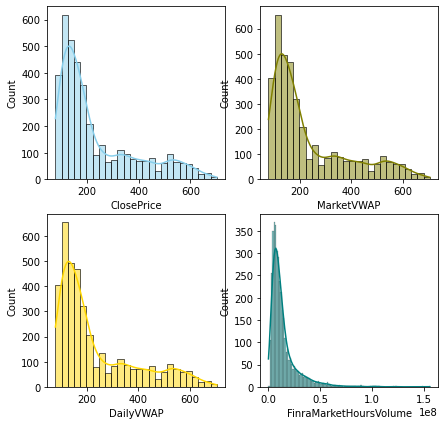

In [35]:
fig, axs = plt.subplots(2, 2, figsize=(7, 7))

sns.histplot(data=aapl, x="ClosePrice", kde=True, color="skyblue", ax=axs[0, 0])
sns.histplot(data=aapl, x="MarketVWAP", kde=True, color="olive", ax=axs[0, 1])
sns.histplot(data=aapl, x="DailyVWAP", kde=True, color="gold", ax=axs[1, 0])
sns.histplot(data=aapl, x="FinraMarketHoursVolume", kde=True, color="teal", ax=axs[1, 1])

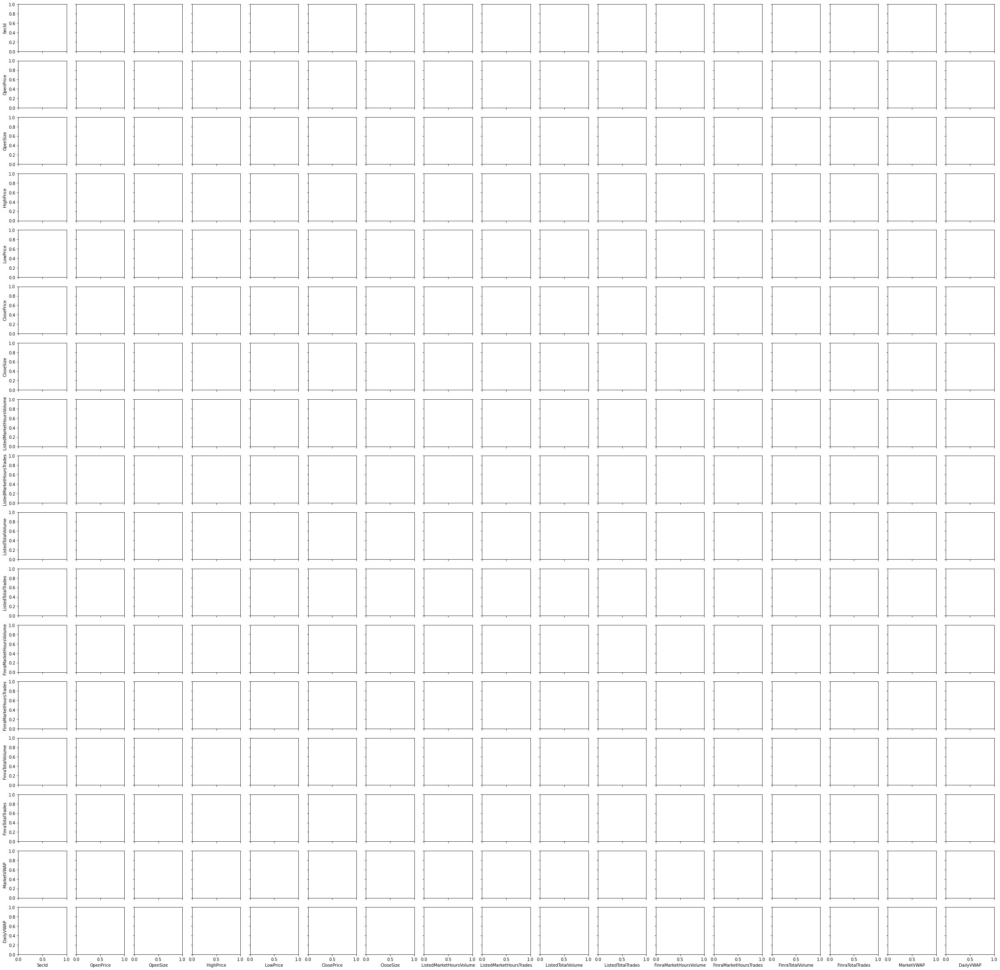

In [ ]:
sns.pairplot(aapl, kind="scatter", hue="ticker", markers=["o", "s", "D"], palette="Set2")
plt.show()

In [38]:
fig = px.scatter_matrix(data)
fig.show()

In [43]:
data = aapl.drop(columns=['SecId','Ticker','ISIN','Name','PrimaryExchange','OpenTime','CloseTime','HighTime','LowTime'])

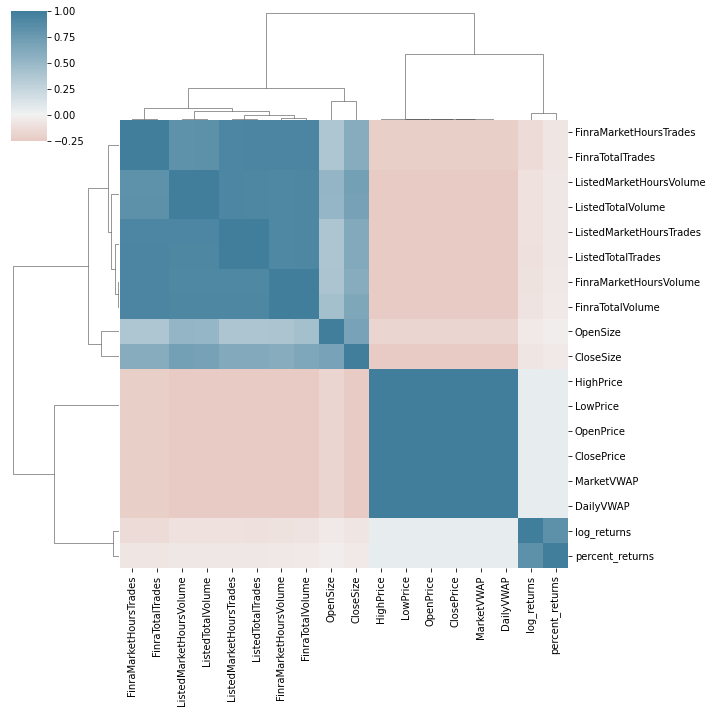

In [44]:
corr = data.corr()
sns.clustermap(corr, cmap = sns.diverging_palette(20, 230, as_cmap=True),
              center=0, vmin=-.25)